In [1]:
import numpy as np
import pandas as pd
import IPython
import re
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df=pd.read_csv('Twitter Mental Health Campaigns 17 to 23.csv')
df

,Date,ID,url,username,source,location,tweet,num_of_likes,num_of_rt,followers,replies,campaign
0,2023-02-15 13:48:52+00:00,1625854658601418753,https://twitter.com/haringeyiapt/status/162585...,haringeyiapt,Twitter for iPhone,Haringey,"People with OCD experience intensely negative,...",5,1,317,0,OCD
1,2023-02-09 22:37:56+00:00,1623813475469344769,https://twitter.com/scrupulOCD_KC/status/16238...,scrupulOCD_KC,Twitter for Android,unknown,Hello all I'm Erika an @IOCDF grassroots advoc...,0,0,9,0,OCD
2,2022-10-20 11:30:07+00:00,1583057973496406016,https://twitter.com/FootstepsCandC/status/1583...,FootstepsCandC,SmarterQueue,Gloucester,"In light of last week's OCD Awareness week, we...",0,0,905,0,OCD
3,2022-10-18 19:42:14+00:00,1582457044451627008,https://twitter.com/IOCDF/status/1582457044451...,IOCDF,Twitter Web App,"Boston, MA",The GIFS now have over 1.4 million views on GI...,5,2,19257,0,OCD
4,2022-10-18 19:42:13+00:00,1582457038969262080,https://twitter.com/IOCDF/status/1582457038969...,IOCDF,Twitter Web App,"Boston, MA","The 2022 #OCDweek events, activities, and live...",7,2,19257,1,OCD
...,...,...,...,...,...,...,...,...,...,...,...,...
724750,2017-01-21 16:57:43+00:00,822850673314295808,https://twitter.com/ConorAllanIRL/status/82285...,ConorAllanIRL,Twitter for iPhone,England,Will you join me for Uni Mental Health Day on ...,0,0,440,0,UMHD
724751,2017-01-21 16:30:49+00:00,822843904068321281,https://twitter.com/StudentMindsOrg/status/822...,StudentMindsOrg,Hootsuite,United Kingdom,Over 6million twitter accounts reached using #...,5,6,24929,0,UMHD
724752,2017-01-11 18:19:02+00:00,819247260848553998,https://twitter.com/StudentMindsYSJ/status/819...,StudentMindsYSJ,Twitter Web Client,York,We're excited for #UniMentalHealthDay &amp; wi...,1,1,269,0,UMHD
724753,2017-01-10 11:23:37+00:00,818780330983354368,https://twitter.com/SHUDisabledRep/status/8187...,SHUDisabledRep,Twitter for Android,"Sheffield, England",Lots of stuff happening over coming month btw:...,1,0,204,0,UMHD


In [3]:
df1=df.copy()
df1

,Date,ID,url,username,source,location,tweet,num_of_likes,num_of_rt,followers,replies,campaign
0,2023-02-15 13:48:52+00:00,1625854658601418753,https://twitter.com/haringeyiapt/status/162585...,haringeyiapt,Twitter for iPhone,Haringey,"People with OCD experience intensely negative,...",5,1,317,0,OCD
1,2023-02-09 22:37:56+00:00,1623813475469344769,https://twitter.com/scrupulOCD_KC/status/16238...,scrupulOCD_KC,Twitter for Android,unknown,Hello all I'm Erika an @IOCDF grassroots advoc...,0,0,9,0,OCD
2,2022-10-20 11:30:07+00:00,1583057973496406016,https://twitter.com/FootstepsCandC/status/1583...,FootstepsCandC,SmarterQueue,Gloucester,"In light of last week's OCD Awareness week, we...",0,0,905,0,OCD
3,2022-10-18 19:42:14+00:00,1582457044451627008,https://twitter.com/IOCDF/status/1582457044451...,IOCDF,Twitter Web App,"Boston, MA",The GIFS now have over 1.4 million views on GI...,5,2,19257,0,OCD
4,2022-10-18 19:42:13+00:00,1582457038969262080,https://twitter.com/IOCDF/status/1582457038969...,IOCDF,Twitter Web App,"Boston, MA","The 2022 #OCDweek events, activities, and live...",7,2,19257,1,OCD
...,...,...,...,...,...,...,...,...,...,...,...,...
724750,2017-01-21 16:57:43+00:00,822850673314295808,https://twitter.com/ConorAllanIRL/status/82285...,ConorAllanIRL,Twitter for iPhone,England,Will you join me for Uni Mental Health Day on ...,0,0,440,0,UMHD
724751,2017-01-21 16:30:49+00:00,822843904068321281,https://twitter.com/StudentMindsOrg/status/822...,StudentMindsOrg,Hootsuite,United Kingdom,Over 6million twitter accounts reached using #...,5,6,24929,0,UMHD
724752,2017-01-11 18:19:02+00:00,819247260848553998,https://twitter.com/StudentMindsYSJ/status/819...,StudentMindsYSJ,Twitter Web Client,York,We're excited for #UniMentalHealthDay &amp; wi...,1,1,269,0,UMHD
724753,2017-01-10 11:23:37+00:00,818780330983354368,https://twitter.com/SHUDisabledRep/status/8187...,SHUDisabledRep,Twitter for Android,"Sheffield, England",Lots of stuff happening over coming month btw:...,1,0,204,0,UMHD


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724755 entries, 0 to 724754
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   Date          724755 non-null  object
 1   ID            724755 non-null  int64 
 2   url           724755 non-null  object
 3   username      724755 non-null  object
 4   source        724755 non-null  object
 5   location      724755 non-null  object
 6   tweet         724755 non-null  object
 7   num_of_likes  724755 non-null  int64 
 8   num_of_rt     724755 non-null  int64 
 9   followers     724755 non-null  int64 
 10  replies       724755 non-null  int64 
 11  campaign      724755 non-null  object
dtypes: int64(5), object(7)
memory usage: 66.4+ MB


In [5]:
# Change the date into datetime series
df=pd.read_csv('Twitter Mental Health Campaigns 17 to 23.csv', parse_dates=['Date'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724755 entries, 0 to 724754
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype              
---  ------        --------------   -----              
 0   Date          724755 non-null  datetime64[ns, UTC]
 1   ID            724755 non-null  int64              
 2   url           724755 non-null  object             
 3   username      724755 non-null  object             
 4   source        724755 non-null  object             
 5   location      724755 non-null  object             
 6   tweet         724755 non-null  object             
 7   num_of_likes  724755 non-null  int64              
 8   num_of_rt     724755 non-null  int64              
 9   followers     724755 non-null  int64              
 10  replies       724755 non-null  int64              
 11  campaign      724755 non-null  object             
dtypes: datetime64[ns, UTC](1), int64(5), object(6)
memory usage: 66.4+ MB


In [6]:
df.drop(columns=['url'], inplace=True) # The url doesn't work anymore so dropping the column

### Preprocessing text data to clean the tweets

In [7]:
!pip install nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('stopwords')
nltk.download('corpus')
              
import nltk
from nltk import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
lemmatizer=WordNetLemmatizer()
from nltk.stem.porter import PorterStemmer

import string
import re

from textblob import TextBlob
from emot.emo_unicode import UNICODE_EMOJI # for emojis
from emot.emo_unicode import EMOTICONS_EMO # for emoticons

DEPRECATION: pyodbc 4.0.0-unsupported has a non-standard version number. pip 24.1 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pyodbc or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063


<IPython.core.display.Javascript object>

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aryan\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


<IPython.core.display.Javascript object>

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\aryan\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


<IPython.core.display.Javascript object>

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\aryan\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


<IPython.core.display.Javascript object>

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aryan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


<IPython.core.display.Javascript object>

[nltk_data] Error loading corpus: Package 'corpus' not found in index


In [8]:
emoji = list(UNICODE_EMOJI.keys())

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724755 entries, 0 to 724754
Data columns (total 11 columns):
 #   Column        Non-Null Count   Dtype              
---  ------        --------------   -----              
 0   Date          724755 non-null  datetime64[ns, UTC]
 1   ID            724755 non-null  int64              
 2   username      724755 non-null  object             
 3   source        724755 non-null  object             
 4   location      724755 non-null  object             
 5   tweet         724755 non-null  object             
 6   num_of_likes  724755 non-null  int64              
 7   num_of_rt     724755 non-null  int64              
 8   followers     724755 non-null  int64              
 9   replies       724755 non-null  int64              
 10  campaign      724755 non-null  object             
dtypes: datetime64[ns, UTC](1), int64(5), object(5)
memory usage: 60.8+ MB


In [10]:
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words=set(stop_words)
print(stop_words)

{'o', 'ourselves', 'him', 'where', 'as', 'both', 'an', 'again', 'how', 'against', 'needn', 'to', "you'd", 'before', 'some', 'between', 'into', 'does', 'any', 'isn', 'hers', "mustn't", 'if', 'haven', 'now', 'don', 'your', "hadn't", 'yours', 'from', 'further', "you've", 'didn', "wasn't", 'above', 'itself', 'aren', 'will', 'you', 'being', 'such', 'these', 'too', 'wouldn', 'only', 'mustn', "you'll", "don't", 'at', 'nor', 'out', 'the', 'are', 'here', 'then', 'when', "didn't", 'those', 'in', 'each', "doesn't", 'hadn', 'do', 'm', 'hasn', 'ours', 'mightn', "she's", 'couldn', 's', 'his', 'own', 'or', 'and', 'all', 'should', 'them', 'up', "haven't", 'was', 'by', 'about', 're', 'until', 'myself', 'me', "you're", 'once', 'than', 'ma', 'whom', "aren't", 'on', 'y', 'my', 'there', 'he', "that'll", 'ain', 'but', 'himself', 'why', 'their', 'of', 'wasn', 'what', 'while', 'her', 'did', 'it', "it's", 'themselves', "mightn't", 'its', 'more', 'few', 'weren', "wouldn't", 'down', 'shouldn', "needn't", 'they',

In [11]:
# Data preprocessing

def clean_tokens(text):
    # 1 create tokens
    tokens = word_tokenize(text)
    # 2 lower case
    tokens = [w.lower() for w in tokens]
    # 3 remove punctuations
    stripped = [word for word in tokens if word.isalpha()]
    # 4 remove stop_words
    stop_words = set(stopwords.words('english'))
    words = [w for w in stripped if not w in stop_words]
    # remove emojis
    no_emoji = [w for w in words if not w in emoji]
    # join cleaned tokens into a single string
    clean_text = ' '.join(no_emoji)
    # return the cleaned string
    return clean_text

In [12]:
df.iloc[310814,:].tweet

'We want to spread some kindness EVERYDAY of the week in support of #MentalHealthAwarenessWeek ✨ For the chance to #WIN a Pretty Little Parcel, all you have to do is: follow us then tweet the hashtag #LovePLT 💕 and remember, be kind always 💘'

In [13]:
string_check="We want to spread some kindness EVERYDAY of the week in support of #MentalHealthAwarenessWeek ✨ For the chance to #WIN a Pretty Little Parcel, all you have to do is: follow us then tweet the hashtag #LovePLT 💕 and remember, be kind always 💘"

In [14]:
clean_tokens(string_check)

'want spread kindness everyday week support mentalhealthawarenessweek chance win pretty little parcel follow us tweet hashtag loveplt remember kind always'

In [15]:
df['processed_tweet'] = df.tweet.apply(lambda x: clean_tokens(x))
df.head(5)

,Date,ID,username,source,location,tweet,num_of_likes,num_of_rt,followers,replies,campaign,processed_tweet
0,2023-02-15 13:48:52+00:00,1625854658601418753,haringeyiapt,Twitter for iPhone,Haringey,"People with OCD experience intensely negative,...",5,1,317,0,OCD,people ocd experience intensely negative repet...
1,2023-02-09 22:37:56+00:00,1623813475469344769,scrupulOCD_KC,Twitter for Android,unknown,Hello all I'm Erika an @IOCDF grassroots advoc...,0,0,9,0,OCD,hello erika iocdf grassroots advocate loves ro...
2,2022-10-20 11:30:07+00:00,1583057973496406016,FootstepsCandC,SmarterQueue,Gloucester,"In light of last week's OCD Awareness week, we...",0,0,905,0,OCD,light last week ocd awareness week wanted offe...
3,2022-10-18 19:42:14+00:00,1582457044451627008,IOCDF,Twitter Web App,"Boston, MA",The GIFS now have over 1.4 million views on GI...,5,2,19257,0,OCD,gifs million views giphy hope campaign shifts ...
4,2022-10-18 19:42:13+00:00,1582457038969262080,IOCDF,Twitter Web App,"Boston, MA","The 2022 #OCDweek events, activities, and live...",7,2,19257,1,OCD,ocdweek events activities livestreams led amaz...


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724755 entries, 0 to 724754
Data columns (total 12 columns):
 #   Column           Non-Null Count   Dtype              
---  ------           --------------   -----              
 0   Date             724755 non-null  datetime64[ns, UTC]
 1   ID               724755 non-null  int64              
 2   username         724755 non-null  object             
 3   source           724755 non-null  object             
 4   location         724755 non-null  object             
 5   tweet            724755 non-null  object             
 6   num_of_likes     724755 non-null  int64              
 7   num_of_rt        724755 non-null  int64              
 8   followers        724755 non-null  int64              
 9   replies          724755 non-null  int64              
 10  campaign         724755 non-null  object             
 11  processed_tweet  724755 non-null  object             
dtypes: datetime64[ns, UTC](1), int64(5), object(6)
memory usag

In [17]:
df.to_csv('MH Campaign Tweets Cleaned 17 to 23.csv', index=False) # Creating a new csv file 

In [19]:
df= pd.read_csv('MH Campaign Tweets Cleaned 17 to 23.csv')
df

,Date,ID,username,source,location,tweet,num_of_likes,num_of_rt,followers,replies,campaign,processed_tweet
0,2023-02-15 13:48:52+00:00,1625854658601418753,haringeyiapt,Twitter for iPhone,Haringey,"People with OCD experience intensely negative,...",5,1,317,0,OCD,people ocd experience intensely negative repet...
1,2023-02-09 22:37:56+00:00,1623813475469344769,scrupulOCD_KC,Twitter for Android,unknown,Hello all I'm Erika an @IOCDF grassroots advoc...,0,0,9,0,OCD,hello erika iocdf grassroots advocate loves ro...
2,2022-10-20 11:30:07+00:00,1583057973496406016,FootstepsCandC,SmarterQueue,Gloucester,"In light of last week's OCD Awareness week, we...",0,0,905,0,OCD,light last week ocd awareness week wanted offe...
3,2022-10-18 19:42:14+00:00,1582457044451627008,IOCDF,Twitter Web App,"Boston, MA",The GIFS now have over 1.4 million views on GI...,5,2,19257,0,OCD,gifs million views giphy hope campaign shifts ...
4,2022-10-18 19:42:13+00:00,1582457038969262080,IOCDF,Twitter Web App,"Boston, MA","The 2022 #OCDweek events, activities, and live...",7,2,19257,1,OCD,ocdweek events activities livestreams led amaz...
...,...,...,...,...,...,...,...,...,...,...,...,...
724750,2017-01-21 16:57:43+00:00,822850673314295808,ConorAllanIRL,Twitter for iPhone,England,Will you join me for Uni Mental Health Day on ...,0,0,440,0,UMHD,join uni mental health day march https
724751,2017-01-21 16:30:49+00:00,822843904068321281,StudentMindsOrg,Hootsuite,United Kingdom,Over 6million twitter accounts reached using #...,5,6,24929,0,UMHD,twitter accounts reached using unimentalhealth...
724752,2017-01-11 18:19:02+00:00,819247260848553998,StudentMindsYSJ,Twitter Web Client,York,We're excited for #UniMentalHealthDay &amp; wi...,1,1,269,0,UMHD,excited unimentalhealthday amp begin planning ...
724753,2017-01-10 11:23:37+00:00,818780330983354368,SHUDisabledRep,Twitter for Android,"Sheffield, England",Lots of stuff happening over coming month btw:...,1,0,204,0,UMHD,lots stuff happening coming month btw uni ment...


In [20]:
df['year'] = pd.DatetimeIndex(df['Date']).year

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724755 entries, 0 to 724754
Data columns (total 13 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   Date             724755 non-null  object
 1   ID               724755 non-null  int64 
 2   username         724755 non-null  object
 3   source           724755 non-null  object
 4   location         724755 non-null  object
 5   tweet            724755 non-null  object
 6   num_of_likes     724755 non-null  int64 
 7   num_of_rt        724755 non-null  int64 
 8   followers        724755 non-null  int64 
 9   replies          724755 non-null  int64 
 10  campaign         724755 non-null  object
 11  processed_tweet  724744 non-null  object
 12  year             724755 non-null  int64 
dtypes: int64(6), object(7)
memory usage: 71.9+ MB


In [22]:
df_copy =df.copy()

In [23]:
import plotly.express as px

df_filtered = df[df['year'] != 2023]

# Create a dataframe with campaign counts and colors
df_campaign = pd.DataFrame({
    'campaign': ['ED (non-EDAW)', 'EDAW'],
    'counts': [4250, 2075],
    'colors': ['#71C4C0', '#953D8C']
})

fig = px.pie(df_campaign, values='counts', names='campaign', color='colors',
             color_discrete_sequence=df_campaign['colors'], hole=.6,
             custom_data=[df_campaign['campaign'].value_counts().apply(lambda x: f"{x:,}").tolist(), ['tweets', 'tweets']])
fig.update_traces(textposition='inside', textinfo='percent', 
                  hovertemplate='%{label}: %{percent}<br>Tweets: %{customdata[0]}')
fig.update_layout(
    width=800, 
    height=600,
    margin=dict(t=100, l=0, r=0, b=0),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    title={"text": "Tweets about Eating Disorders, 1st of January 2017 to 31st December 2022",
           "y":0.95, "x":0.5, "xanchor": "center", "yanchor": "top"}
)
fig.show()

In [24]:
df.iloc[310814,:].tweet

'We want to spread some kindness EVERYDAY of the week in support of #MentalHealthAwarenessWeek ✨ For the chance to #WIN a Pretty Little Parcel, all you have to do is: follow us then tweet the hashtag #LovePLT 💕 and remember, be kind always 💘'

In [25]:
df.iloc[310814,:].processed_tweet
#can see that the function which processed the tweets has returned them as a list of tokens.

'want spread kindness everyday week support mentalhealthawarenessweek chance win pretty little parcel follow us tweet hashtag loveplt remember kind always'

In [26]:
#selecting just the EDAW tweets, whch have been cleaned
EDAW_tweets = df[df['campaign']=='EDAW']['processed_tweet']
EDAW_tweets = [str(tweet) for tweet in EDAW_tweets]
EDAW_tweets

['eating disorders awareness week one still acutely aware presence eatingdisorders life would like confine awareness one week year someone could sort',
 'tulyrq thats okay',
 'tulyrq yikes',
 'even care nah fine',
 'preset green pink primary',
 'amazing keep',
 'sorry',
 'gl man hit subs march never forget',
 'mindcharity wrote blog post experiences edaw last year good well informed gp make difference https',
 'excerpts booklet edaw made stories poems art people living lived experience read full https https',
 'diversity family experiences recording available https thanks ken maura hayes harrietparsons caredireland caredscork ldceds saramcdevitt https',
 'mp speaks eating disorders awareness week carolyn harris chair westminster hall debates https https',
 'mp speaks eating disorders awareness week carolyn harris chair westminster hall debates https https',
 'teamaresggs would much would like added list',
 'literall shit twitter account bc whole point actual content goodnight',
 'damn 

In [27]:
#selecting just the ED tweets, whch have been cleaned
ED_tweets = df[df['campaign']=='ED']['processed_tweet']
ED_tweets = [str(tweet) for tweet in ED_tweets]
ED_tweets

['grateful working fantastic group advisors collaborators navigate intersection obesity eatingdisorders part obesity amp eating disorders speculation amp data conscienhealth https',
 'podcast episode chat dr beth shelton psychologist amp director highly respected professional field beth leads team develops national standards preventing amp treating https https',
 'trauma low self concept media influences common underlying factors contribute development bulimia eatingdisorders anorexy healthcare https',
 'must read enthralling captivating journey life author https religion spirituality eatingdisorders spiritualhealing',
 'personalised amp adapted treatments identify available maudsleyprivate coming soon maudsleyprivate bespoke eatingdisorders autism assessment treatment packages beated katetchanturia autism personalisedcare',
 'proud professors katetchanturia kingsmaudsley dogged determination ensure people understood new innovative treatments developed offered real time need maudsleypr

In [28]:
#selecting just the MHAW tweets, whch have been cleaned
MHAW_tweets = df[df['campaign']=='MHAW']['processed_tweet']
MHAW_tweets = [str(tweet) for tweet in MHAW_tweets]
MHAW_tweets

['reflecting back mentalhealthawareness week earlier year people first better results believe never apparent year mental health awareness week bringing us closer together agency mentalhealth https',
 'thoughts shared may mental health awareness week https',
 'livestream video high school video mental health awareness week really popular',
 'shylasopinions may mental health awareness week',
 'mental health awareness week https',
 'remember mentalhealthawarenessweek talking stop https grlpowrchat talkmh mhchat bloggerstribe teacupclub',
 'mental health awareness week swimming meditation mindfulness https',
 'added video youtube playlist https high functioning depression mental health awareness week day five',
 'mental health awareness week https',
 'christmas may one gift year goes samhtweets announce final total raised mental health awareness week campaign euwafc https',
 'mental health awareness week today marks start mental health awareness week fro https mentalhealth',
 'us surviving

In [29]:
#selecting just the UMHD tweets, whch have been cleaned
UMHD_tweets = df[df['campaign']=='UMHD']['processed_tweet']
UMHD_tweets = [str(tweet) for tweet in UMHD_tweets]
UMHD_tweets

['light unimentalhealthday march encourage learn studentmentalhealth brilliant podcast discover particular groups students vulnerable mentalhealth issues university https https',
 'going university college exciting challenging bereaved young people feel particularly vulnerable animation made students shows support help contact us via live chat https unimentalhealthday https',
 'thank everyone attended online event unimentalhealthday proud panellists hosts rosie aneeshka quotes day want watch whole event https',
 'unimentalhealthday teams lancaster reading amp durham held events introducing residents local resources support services maintaining mental health amp wellbeing throughout studies students uni studentaccommodation wellbeing university student https',
 'check minute video students share thoughts stigma issues accessing services pressures student life words wisdom new students thanks sharing stories unimentalhealthday studentmentalhealth',
 'join team universitymentalhealthday t

In [30]:
#selecting just the OCD tweets, whch have been cleaned
OCD_tweets = df[df['campaign']=='OCD']['processed_tweet']
OCD_tweets = [str(tweet) for tweet in OCD_tweets]
OCD_tweets

['people ocd experience intensely negative repetitive intrusive thoughts chronic feeling doubt danger calm anxiety people ocd often repeat action known compulsions experience therapy help ocdweek ocd https',
 'hello erika iocdf grassroots advocate loves rockyourvalues painting rocks spread awareness lower stigma ocd community look back ocdweek excited workshop end feb https',
 'light last week ocd awareness week wanted offer signposting options may experiencing symptoms please reach gp ocd action helpline click info https ocdweek https',
 'gifs million views giphy hope campaign shifts perception people ocd thank participated ocdweek continue focus offering supportive community look forward next year',
 'ocdweek events activities livestreams led amazing participation engagement year programming developed dedicated group iocdf advocates national advocates lead advocates included live events cont',
 'catch last week ask experts livestream kevin anderson tom smalley ocdweek hosted liz amp 

### EDAW Tweets

In [31]:
EDAW_tweets

['eating disorders awareness week one still acutely aware presence eatingdisorders life would like confine awareness one week year someone could sort',
 'tulyrq thats okay',
 'tulyrq yikes',
 'even care nah fine',
 'preset green pink primary',
 'amazing keep',
 'sorry',
 'gl man hit subs march never forget',
 'mindcharity wrote blog post experiences edaw last year good well informed gp make difference https',
 'excerpts booklet edaw made stories poems art people living lived experience read full https https',
 'diversity family experiences recording available https thanks ken maura hayes harrietparsons caredireland caredscork ldceds saramcdevitt https',
 'mp speaks eating disorders awareness week carolyn harris chair westminster hall debates https https',
 'mp speaks eating disorders awareness week carolyn harris chair westminster hall debates https https',
 'teamaresggs would much would like added list',
 'literall shit twitter account bc whole point actual content goodnight',
 'damn 

In [32]:
joined_tweets = " ".join(EDAW_tweets) #joining all EDAW tweets in one big quote

In [33]:
list_words = ['edaw', 'eating', 'disorders', 'disorder','eatingdisorders','eatingdisorderawarenessweek',
                   'awareness','week','amp','http','https', 'MentalHealthAwarenessWeek', 'mental', 
              'health', 'day', 'uni', 'umhd', 'universitymentalhealthday', 'unimentalhealthday','ocd','ocdweek']

In [34]:
word_cloud_stopwords=set(stopwords.words('english'))
word_cloud_stopwords.update(list_words)

In [35]:
!pip install wordcloud
import wordcloud as WordCloud
from wordcloud import WordCloud

DEPRECATION: pyodbc 4.0.0-unsupported has a non-standard version number. pip 24.1 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pyodbc or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063


(-0.5, 599.5, 399.5, -0.5)

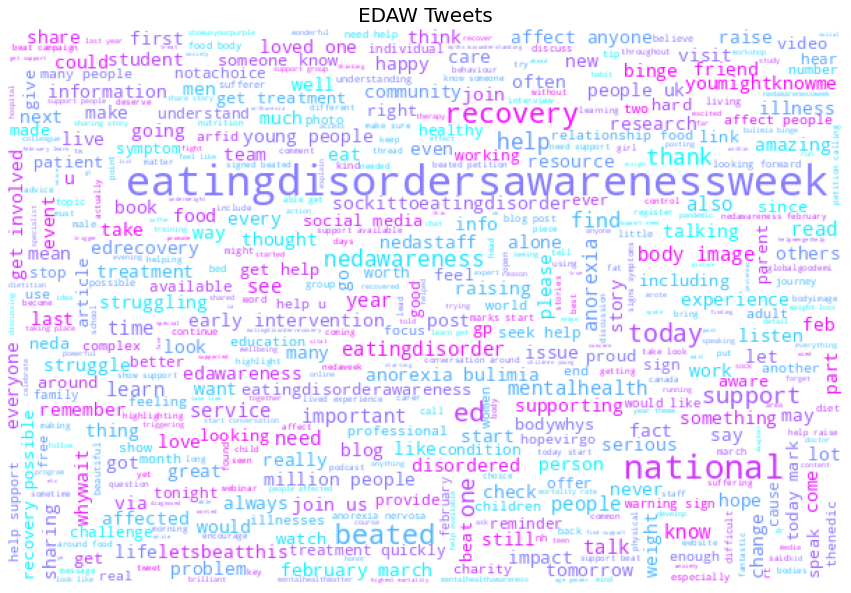

In [36]:
# EDAW Tweets
plt.figure(figsize=(15,13))

wc = WordCloud(width=600,
               height=400,background_color='white',       
               max_words=10000, 
               stopwords=word_cloud_stopwords
               , max_font_size= 30)

wc.generate(joined_tweets)
plt.title("EDAW Tweets", fontsize=20)
plt.imshow(wc.recolor( colormap= 'cool' , random_state=17), alpha=0.98)
plt.axis('off')

In [37]:
# campaign, year, and stop words as parameters.
def campaign_wordcloud(df,campaign_name,desired_year, remove_words_list, dpi=300):
    from wordcloud import WordCloud
    import matplotlib.pyplot as plt
    tweets = df[(df['campaign']==campaign_name)&(df['year']==desired_year)]['processed_tweet']#select the tweets by campaign and year
    string = [str(tweet) for tweet in tweets] #select the tweets by campaign and year
    joined_tweets = " ".join(string)#join all tweet words together into one quote
    words_to_remove = set(remove_words_list)#words that should be removed
    
# Generate the wordcloud, excluding the words in remove_words_list
    plt.figure(figsize=(30,30), dpi=dpi)
    wc = WordCloud(width=600,
                   height=400,background_color="white", 
                   max_words=10000, stopwords=remove_words_list, max_font_size= 60)
    word_cloud_stopwords.update(remove_words_list)
    wc.generate(joined_tweets)
    plt.title(campaign_name + " " + str(desired_year), fontsize=30)
    plt.imshow(wc.recolor( colormap= 'cool' , random_state=17), alpha=0.98)
    plt.axis('off')
    plt.show()

In [38]:
words_to_remove = ['edawareness','people','binge','bingeeating','anorexia','support','Anorexia','Bulimia', 'bulimia',
             'Nervosa','nervosa','recovery','hope','edrecovery','nedastaff','ed', 'national','eatingdisorder',
             'beated','mentalhealth','nedawareness', 'disordered', 'eatingdisorderawareness','Eds'
             'eatingdisordersawarenessweek','edaw','eating', 'disorders', 'february','march',
             'disorder','eatingdisorders','eatingdisorderawarenessweek','eatingdisordersawarenessweek',
                   'awareness','week','amp','http','https', 'MentalHealthAwarenessWeek', 'mental', 
              'health', 'day', 'uni', 'umhd', 'universitymentalhealthday', 'unimentalhealthday','ocd','ocdweek']

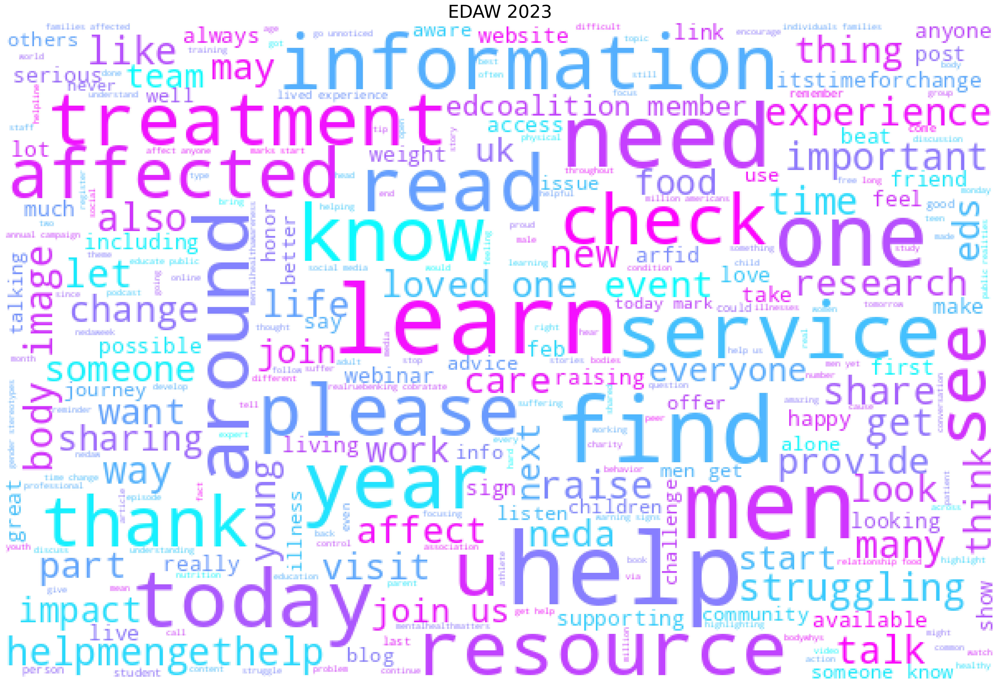

In [39]:
campaign_wordcloud(df,'EDAW', 2023, words_to_remove)

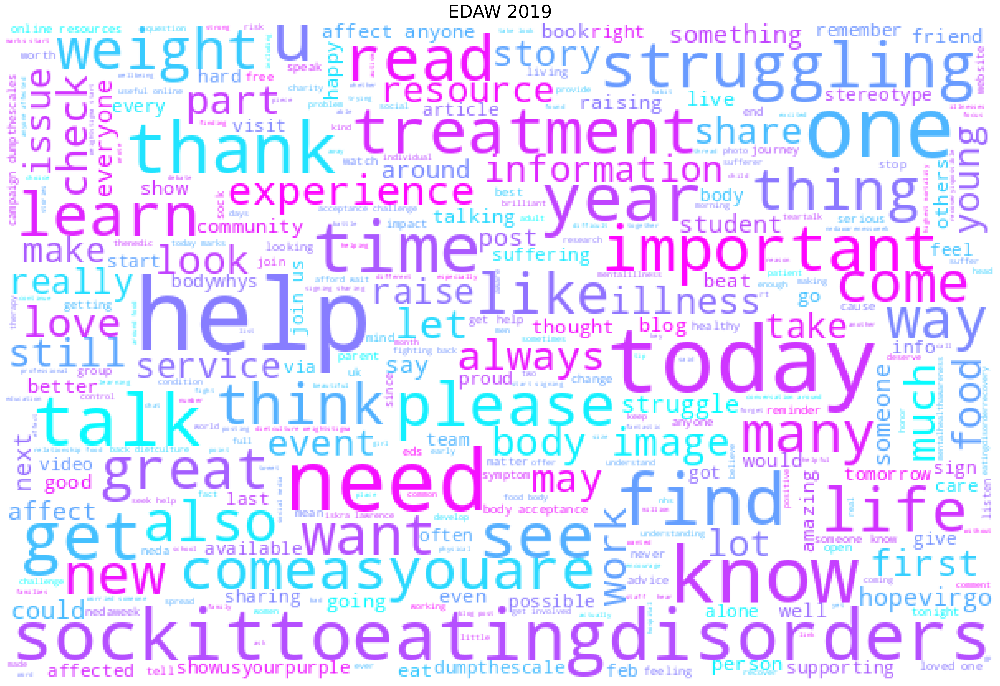

In [40]:
campaign_wordcloud(df,'EDAW', 2019, words_to_remove)

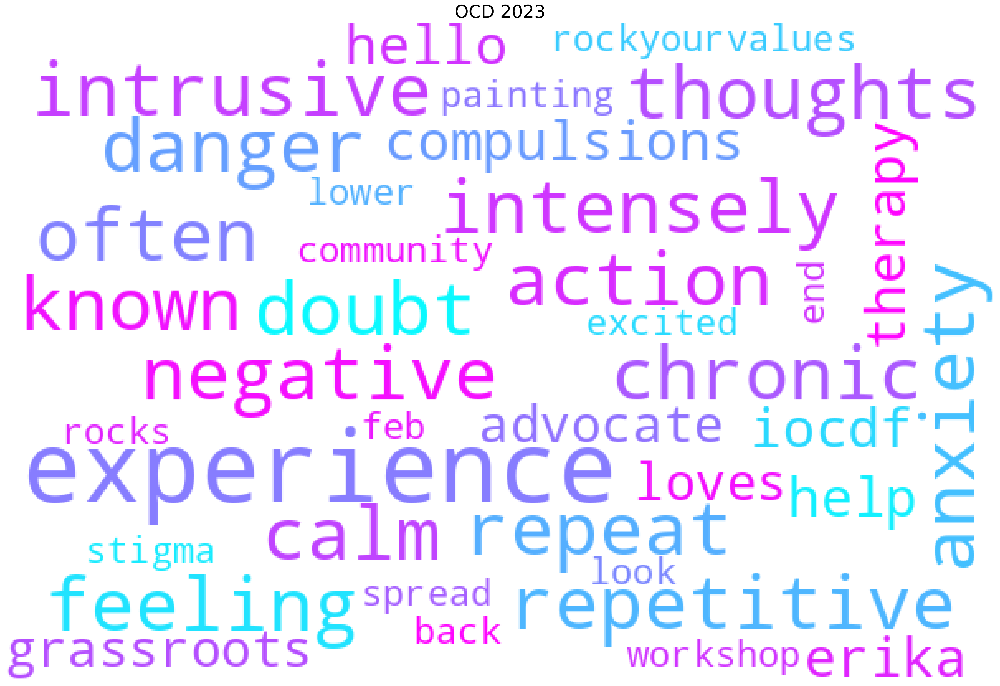

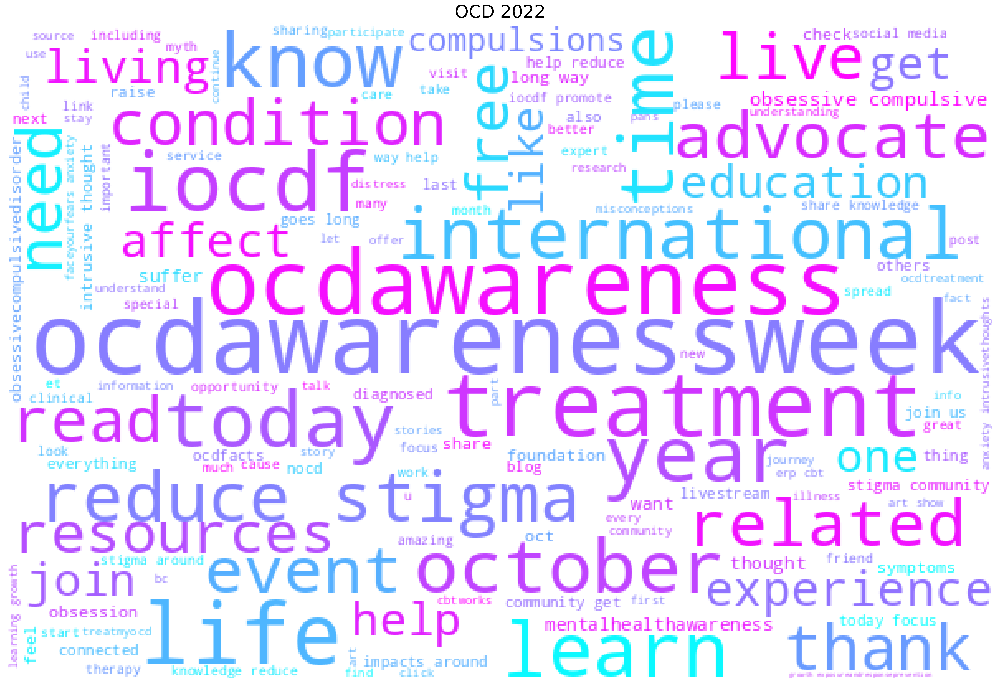

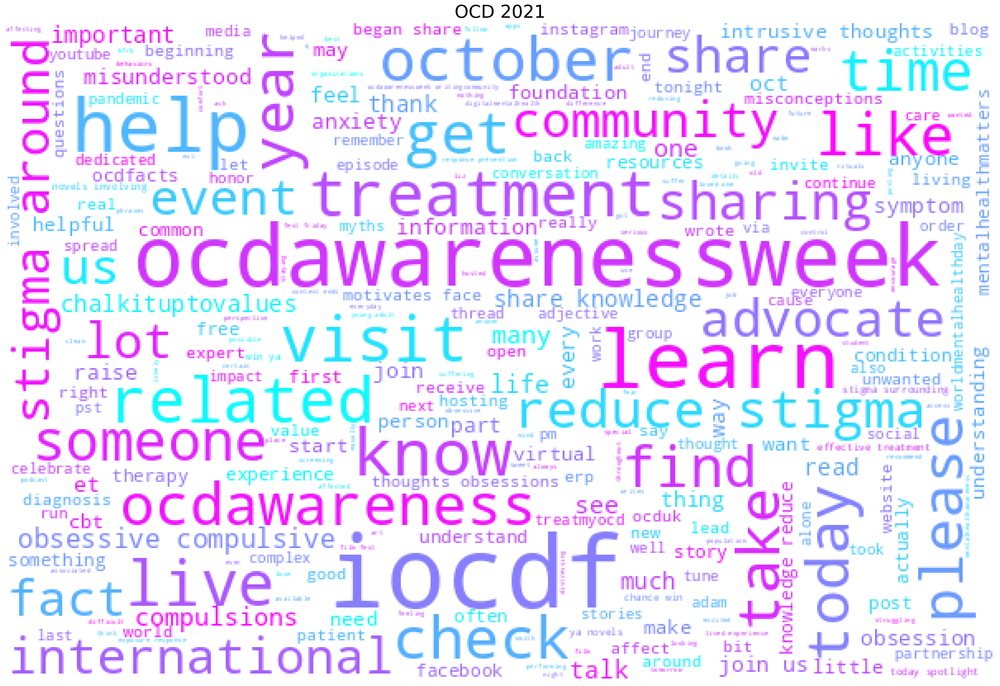

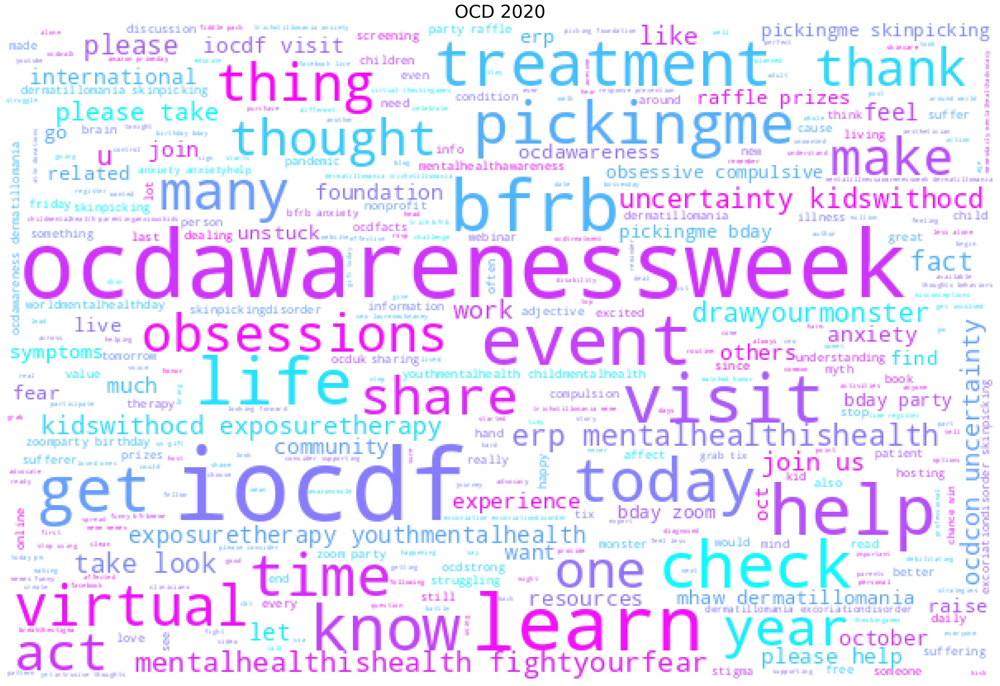

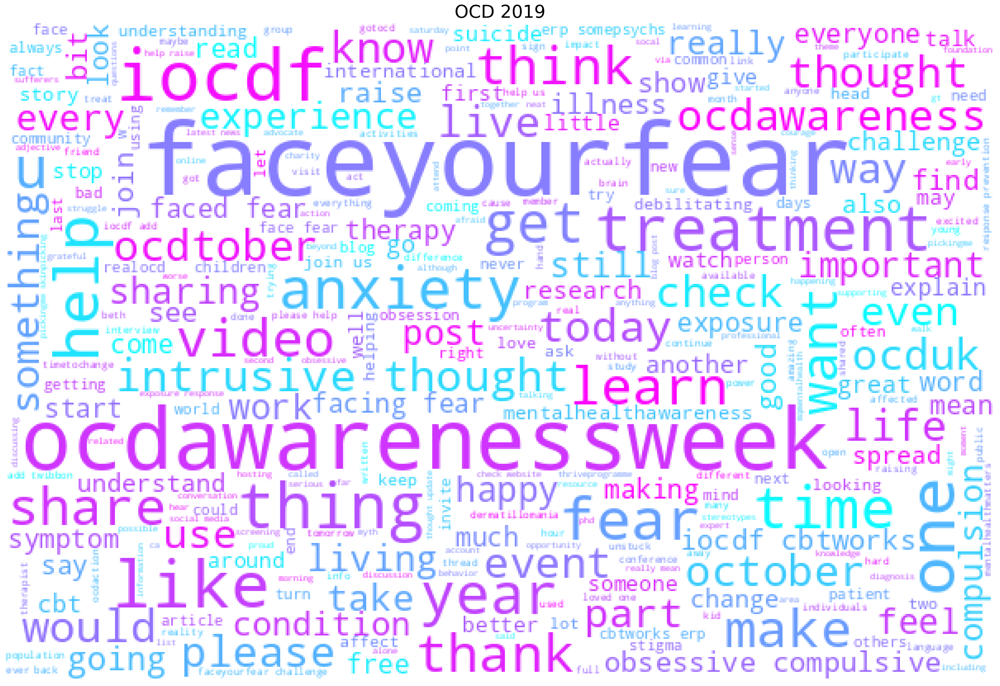

...

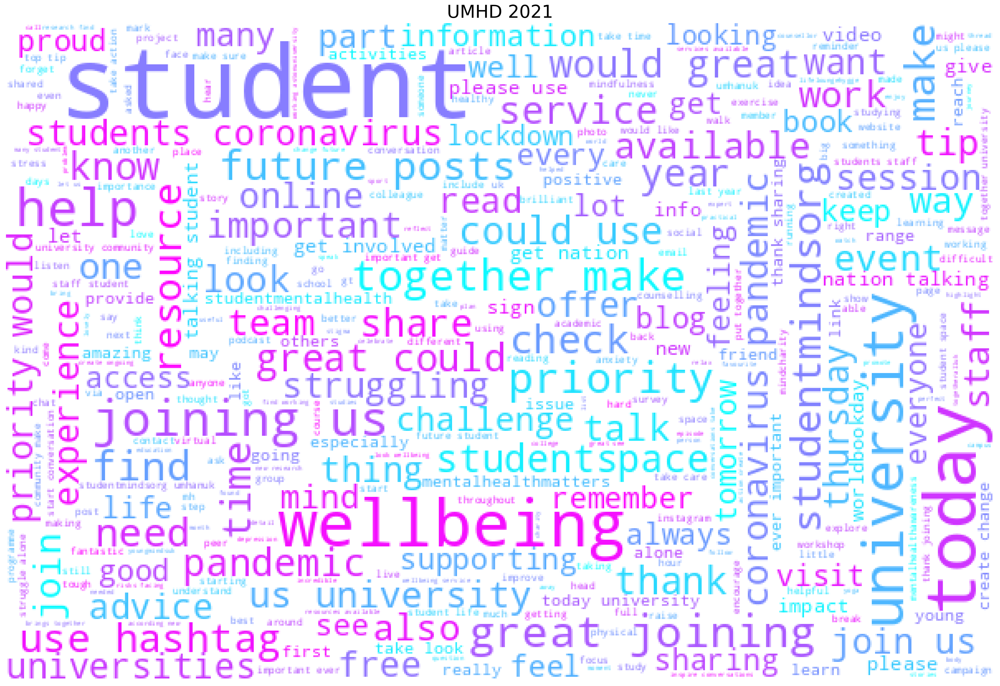

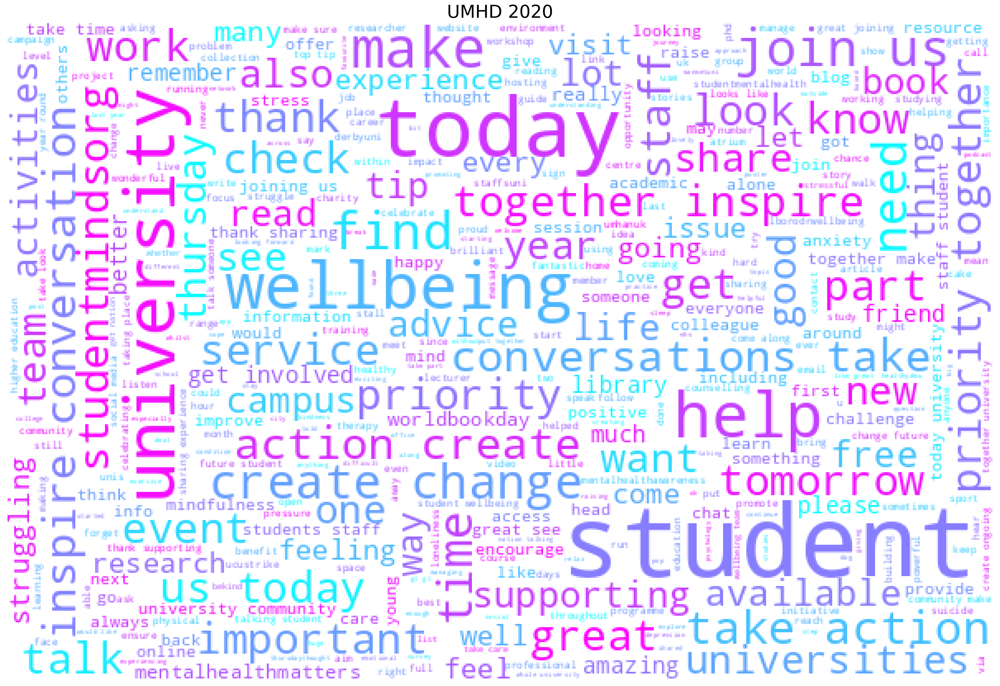

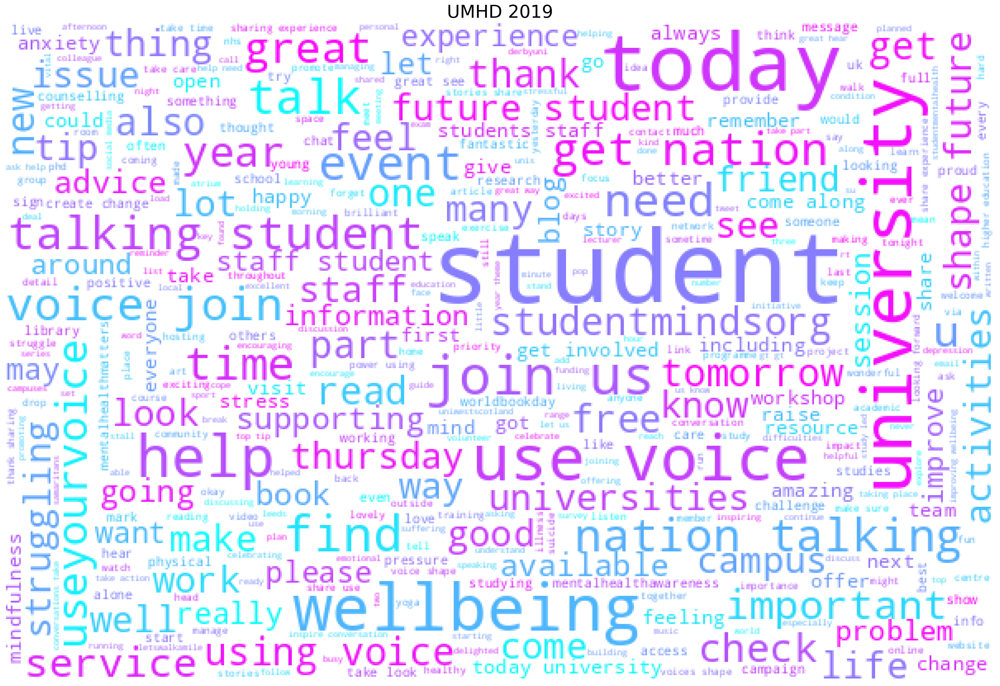

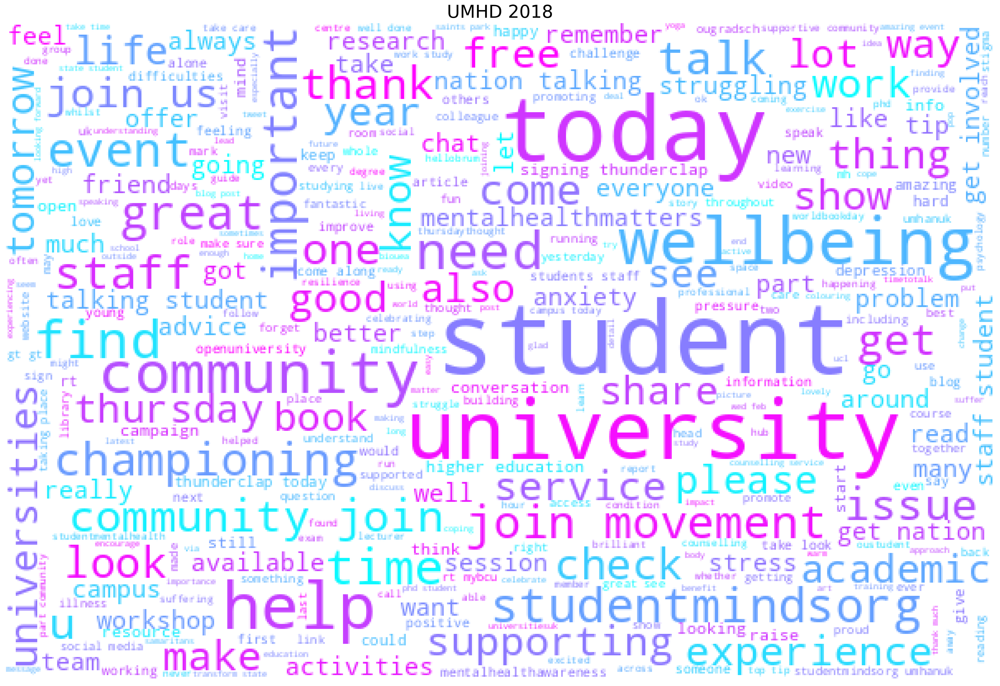

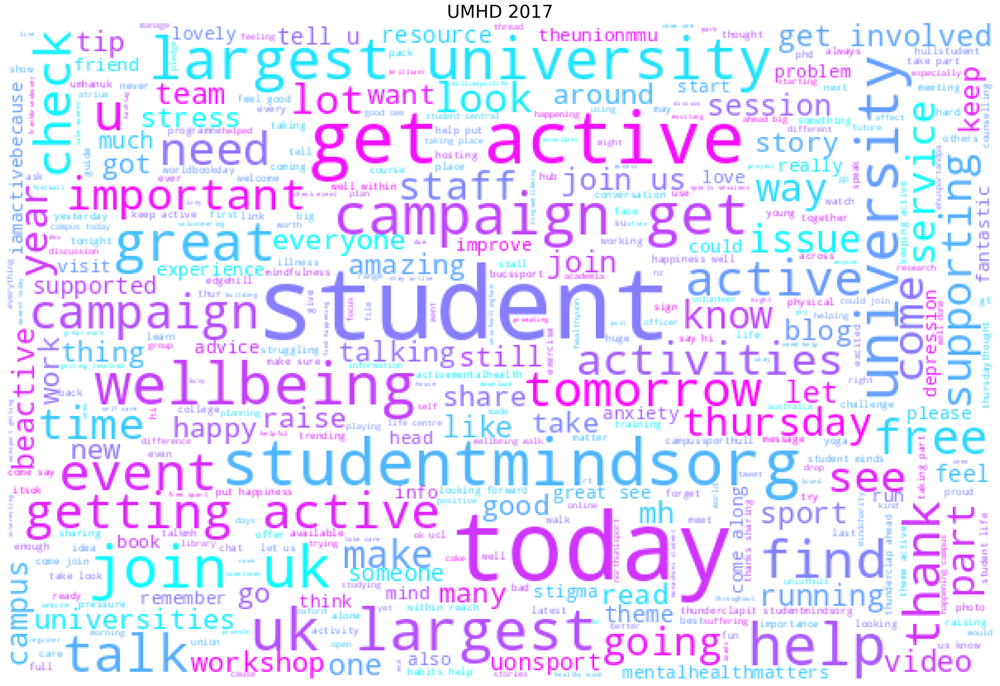

In [41]:
campaigns = df['campaign'].unique()
years = df['year'].unique()

# remove_words_list to use for all wordclouds
remove_words_list = words_to_remove

# generate wordcloud for each campaign and year combination
for campaign in campaigns:
    for year in years:
        campaign_wordcloud(df, campaign, year, words_to_remove)

In [42]:
df['processed_tweet'].isnull().sum()

11

In [43]:
df

,Date,ID,username,source,location,tweet,num_of_likes,num_of_rt,followers,replies,campaign,processed_tweet,year
0,2023-02-15 13:48:52+00:00,1625854658601418753,haringeyiapt,Twitter for iPhone,Haringey,"People with OCD experience intensely negative,...",5,1,317,0,OCD,people ocd experience intensely negative repet...,2023
1,2023-02-09 22:37:56+00:00,1623813475469344769,scrupulOCD_KC,Twitter for Android,unknown,Hello all I'm Erika an @IOCDF grassroots advoc...,0,0,9,0,OCD,hello erika iocdf grassroots advocate loves ro...,2023
2,2022-10-20 11:30:07+00:00,1583057973496406016,FootstepsCandC,SmarterQueue,Gloucester,"In light of last week's OCD Awareness week, we...",0,0,905,0,OCD,light last week ocd awareness week wanted offe...,2022
3,2022-10-18 19:42:14+00:00,1582457044451627008,IOCDF,Twitter Web App,"Boston, MA",The GIFS now have over 1.4 million views on GI...,5,2,19257,0,OCD,gifs million views giphy hope campaign shifts ...,2022
4,2022-10-18 19:42:13+00:00,1582457038969262080,IOCDF,Twitter Web App,"Boston, MA","The 2022 #OCDweek events, activities, and live...",7,2,19257,1,OCD,ocdweek events activities livestreams led amaz...,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...
724750,2017-01-21 16:57:43+00:00,822850673314295808,ConorAllanIRL,Twitter for iPhone,England,Will you join me for Uni Mental Health Day on ...,0,0,440,0,UMHD,join uni mental health day march https,2017
724751,2017-01-21 16:30:49+00:00,822843904068321281,StudentMindsOrg,Hootsuite,United Kingdom,Over 6million twitter accounts reached using #...,5,6,24929,0,UMHD,twitter accounts reached using unimentalhealth...,2017
724752,2017-01-11 18:19:02+00:00,819247260848553998,StudentMindsYSJ,Twitter Web Client,York,We're excited for #UniMentalHealthDay &amp; wi...,1,1,269,0,UMHD,excited unimentalhealthday amp begin planning ...,2017
724753,2017-01-10 11:23:37+00:00,818780330983354368,SHUDisabledRep,Twitter for Android,"Sheffield, England",Lots of stuff happening over coming month btw:...,1,0,204,0,UMHD,lots stuff happening coming month btw uni ment...,2017


In [44]:
df.iloc[1]['processed_tweet']

'hello erika iocdf grassroots advocate loves rockyourvalues painting rocks spread awareness lower stigma ocd community look back ocdweek excited workshop end feb https'

In [45]:
df.iloc[310814,:].processed_tweet

'want spread kindness everyday week support mentalhealthawarenessweek chance win pretty little parcel follow us tweet hashtag loveplt remember kind always'

In [46]:
#df.to_csv('Twitter Mental Health Campaign Tweets Tokenised 17 to 23.csv', index=False)

In [47]:
df.to_csv('MH Campaign Tweets Cleaned 17 to 23.csv', index=False)

In [48]:
df = pd.read_csv('MH Campaign Tweets Cleaned 17 to 23.csv')
df

,Date,ID,username,source,location,tweet,num_of_likes,num_of_rt,followers,replies,campaign,processed_tweet,year
0,2023-02-15 13:48:52+00:00,1625854658601418753,haringeyiapt,Twitter for iPhone,Haringey,"People with OCD experience intensely negative,...",5,1,317,0,OCD,people ocd experience intensely negative repet...,2023
1,2023-02-09 22:37:56+00:00,1623813475469344769,scrupulOCD_KC,Twitter for Android,unknown,Hello all I'm Erika an @IOCDF grassroots advoc...,0,0,9,0,OCD,hello erika iocdf grassroots advocate loves ro...,2023
2,2022-10-20 11:30:07+00:00,1583057973496406016,FootstepsCandC,SmarterQueue,Gloucester,"In light of last week's OCD Awareness week, we...",0,0,905,0,OCD,light last week ocd awareness week wanted offe...,2022
3,2022-10-18 19:42:14+00:00,1582457044451627008,IOCDF,Twitter Web App,"Boston, MA",The GIFS now have over 1.4 million views on GI...,5,2,19257,0,OCD,gifs million views giphy hope campaign shifts ...,2022
4,2022-10-18 19:42:13+00:00,1582457038969262080,IOCDF,Twitter Web App,"Boston, MA","The 2022 #OCDweek events, activities, and live...",7,2,19257,1,OCD,ocdweek events activities livestreams led amaz...,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...
724750,2017-01-21 16:57:43+00:00,822850673314295808,ConorAllanIRL,Twitter for iPhone,England,Will you join me for Uni Mental Health Day on ...,0,0,440,0,UMHD,join uni mental health day march https,2017
724751,2017-01-21 16:30:49+00:00,822843904068321281,StudentMindsOrg,Hootsuite,United Kingdom,Over 6million twitter accounts reached using #...,5,6,24929,0,UMHD,twitter accounts reached using unimentalhealth...,2017
724752,2017-01-11 18:19:02+00:00,819247260848553998,StudentMindsYSJ,Twitter Web Client,York,We're excited for #UniMentalHealthDay &amp; wi...,1,1,269,0,UMHD,excited unimentalhealthday amp begin planning ...,2017
724753,2017-01-10 11:23:37+00:00,818780330983354368,SHUDisabledRep,Twitter for Android,"Sheffield, England",Lots of stuff happening over coming month btw:...,1,0,204,0,UMHD,lots stuff happening coming month btw uni ment...,2017


In [2]:
!pip install nbconvert

!pip install pyppeteer

DEPRECATION: pyodbc 4.0.0-unsupported has a non-standard version number. pip 24.1 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pyodbc or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063


   ---------------------------------------- 82.9/82.9 kB 581.2 kB/s eta 0:00:00
   -------------------------------------- 163.8/163.8 kB 892.6 kB/s eta 0:00:00
   ---------------------------------------- 101.4/101.4 kB 5.7 MB/s eta 0:00:00
  Attempting uninstall: certifi
    Found existing installation: certifi 2021.10.8
    Uninstalling certifi-2021.10.8:


DEPRECATION: pyodbc 4.0.0-unsupported has a non-standard version number. pip 24.1 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pyodbc or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-intel 2.15.0 requires numpy<2.0.0,>=1.23.5, but you have numpy 1.22.4 which is incompatible.


      Successfully uninstalled certifi-2021.10.8
